<a href="https://colab.research.google.com/github/TheLordSaurabh/Credit-Card-Fraud-Detection-Model/blob/main/Credit_Card_Fraud_Detection_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***

### ***Credit Card Fraud Detection (using Ensemble Bagging Models using Logistic Regression and Decision Trees)***


***

#### **Accuracy Achieved**
- ##### ***Achieved Accuracy of about 95.36% and F1-Score of about 95.08% using Ensemble Bagging Model Classifier using Decision Tree Classifiers***
- ##### ***Achieved Accuracy of about 94.84% and F1-Score of about 94.62% using Ensemble Bagging Model Classifier using Logistic Regression Classifiers***
***

#### ***Saurabh Gupta / IIITDM Kancheepuram (B. Tech/CSE/2020-24)***
***


In [3199]:
#Importing modules and dependencies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import seaborn as sns
from scipy.stats import zscore

# Data Cleaning, Preprocessing and Exploratory Data Analysis

In [3200]:
#The Dataset

#The Data Set used here is taken from Internet for Educational & Demonstration purpose only. The author of this project doesn't claim the ownership of this dataset. The complete ownership of this dataset belongs to the organisation which created this dataset.
#Dataset taken from : (https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud)

#Let's load the dataset to a Pandas DataFrame
credit_card_data = pd.read_csv('./credit_card_data.csv')


In [3201]:
#The first 5 rows of the dataset
credit_card_data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [3202]:
#The last 5 rows of the dataset
credit_card_data.tail()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0
284806,172792.0,-0.533413,-0.189733,0.703337,-0.506271,-0.012546,-0.649617,1.577006,-0.414650,0.486180,...,0.261057,0.643078,0.376777,0.008797,-0.473649,-0.818267,-0.002415,0.013649,217.00,0


In [3203]:
# Important Informations about the Dataset
credit_card_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [3204]:
# Let's check the number of missing values in each column

credit_card_data.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [3205]:
all_columns = credit_card_data.columns

In [3206]:
# Let's see the distribution of legit transaction and fraudulent transactions
credit_card_data['Class'].value_counts()

Class
0    284315
1       492
Name: count, dtype: int64

***Remark 1 : The Dataset is highly imbalanced***

**So we need extra processing :**

> **Let : 0 represent Normal Transaction and 1 represent Fraudulent Transaction**



In [3207]:
# Separating Data for Detailed Analysis
fraud = credit_card_data[credit_card_data.Class == 1]
legit = credit_card_data[credit_card_data.Class == 0]

print(legit.shape)
print()
print(fraud.shape)

X_all_unstd = credit_card_data.drop(columns = 'Class', axis = 1)
Y_all = credit_card_data['Class']

(284315, 31)

(492, 31)


In [3208]:
# Statistical Measures of the Legit Data Amount
legit.Amount.describe()

count    284315.000000
mean         88.291022
std         250.105092
min           0.000000
25%           5.650000
50%          22.000000
75%          77.050000
max       25691.160000
Name: Amount, dtype: float64

In [3209]:
# Statistical Measures of the Fraud Data Amount
fraud.Amount.describe()

count     492.000000
mean      122.211321
std       256.683288
min         0.000000
25%         1.000000
50%         9.250000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64

In [3210]:
# Statistical Measures of the Legit Data Time
legit.Time.describe()

count    284315.000000
mean      94838.202258
std       47484.015786
min           0.000000
25%       54230.000000
50%       84711.000000
75%      139333.000000
max      172792.000000
Name: Time, dtype: float64

In [3211]:
# Statistical Measures of the Fraud Data Time
fraud.Time.describe()

count       492.000000
mean      80746.806911
std       47835.365138
min         406.000000
25%       41241.500000
50%       75568.500000
75%      128483.000000
max      170348.000000
Name: Time, dtype: float64

In [3212]:
# Compare the values for both transactions
credit_card_data.groupby("Class").mean()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
Class,,,,,,,,,,,,,,,,,,,,,
0,94838.202258,0.008258,-0.006271,0.012171,-0.007860,0.005453,0.002419,0.009637,-0.000987,0.004467,...,-0.000644,-0.001235,-0.000024,0.000070,0.000182,-0.000072,-0.000089,-0.000295,-0.000131,88.291022
1,80746.806911,-4.771948,3.623778,-7.033281,4.542029,-3.151225,-1.397737,-5.568731,0.570636,-2.581123,...,0.372319,0.713588,0.014049,-0.040308,-0.105130,0.041449,0.051648,0.170575,0.075667,122.211321


## Graphical Visualisation of Time and Amount Labels for samples of each class

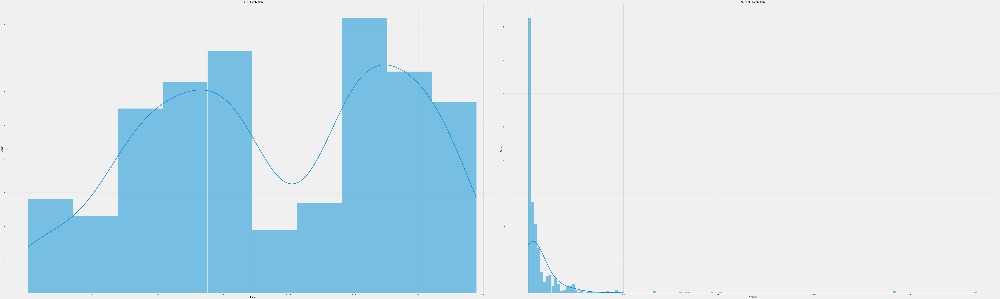

In [3213]:
fig,axs=plt.subplots(1,2,figsize=(100,30))
legitx = legit.sample(492)
sns.histplot(legitx["Time"],ax=axs[0],kde=True)
axs[0].set_title("Time Distribution")

sns.histplot(legitx["Amount"],ax=axs[1],kde=True)
axs[1].set_title("Amount Distribution")

plt.tight_layout(pad=.7)
plt.show()

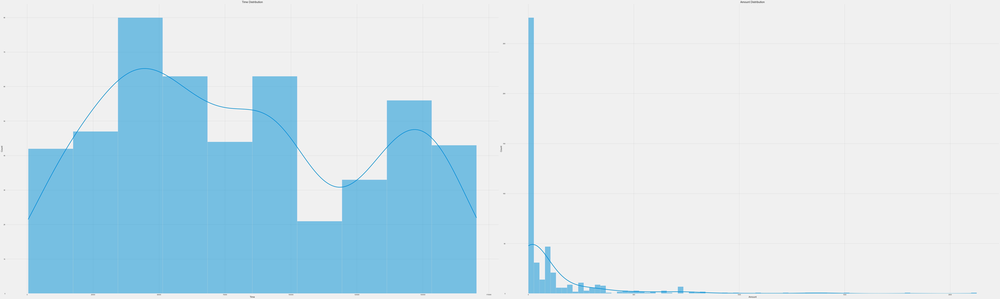

In [3214]:
fig,axs=plt.subplots(1,2,figsize=(100,30))
sns.histplot(fraud["Time"].sample(492),ax=axs[0],kde=True)
axs[0].set_title("Time Distribution")

sns.histplot(fraud["Amount"].sample(492),ax=axs[1],kde=True)
axs[1].set_title("Amount Distribution")

plt.tight_layout(pad=.7)
plt.show()

***Remark 2 : Following general observations can be made based on statistical analysis of the two classes:***
- **(i) Regarding 'Amount' : The average amount of money being transacted in fraud cases is higher than those of Legit Transaction**
- **(ii) Regarding 'Time' : Majority of the Fraud Transactions happens first half of the day and is evenly distributed while the legit transactions happen little after the starting of the day and these legit transactions gradually increase reach to some max level and then it falls and after that it again increases gradually to next high point**

**Let's deal the unbalanced data (high difference in the number of fraud and legit transac.)**

**We will Under-Sampling of Legit Data here**

**Let's take 492 random Fraudulent Transactions and 492 random Legit Transactions**

In [3215]:
legit_sample = legit.sample(n=492)

fraud_sample = fraud.sample(n=492)



*Concatenating two dataframes (legit_sample and fraud_sample)*

In [3216]:
new_dataset = pd.concat([legit_sample,fraud_sample],axis = 0)

In [3217]:
#first 5 rows of new_dataset

new_dataset.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
97845,66407.0,1.047700,-1.188304,0.926659,-0.696854,-0.733028,2.176644,-1.525119,0.827387,-0.165794,...,-0.308137,-0.208229,0.184777,-1.326357,-0.280450,0.890175,0.066777,0.001024,41.63,0
234496,148000.0,2.320144,-0.584930,-2.780143,-1.177819,0.539908,-0.952781,0.199496,-0.341845,-1.014795,...,0.461563,1.287812,-0.241054,0.246366,0.767122,0.286700,-0.114827,-0.107174,1.79,0
3667,3137.0,1.246679,0.067796,0.211026,0.930449,0.046815,0.414423,-0.220463,0.182975,0.421528,...,-0.293359,-0.717699,-0.113769,-0.865866,0.623057,-0.468184,0.029277,0.002466,1.00,0
92966,64192.0,-0.528536,1.163222,0.730085,0.940935,-0.406774,-0.570687,0.400705,0.318691,-0.947077,...,0.248674,0.598885,0.039996,0.552505,-0.174261,-0.368109,-0.154315,-0.046024,42.81,0
276436,167091.0,1.747221,-1.225641,-2.842732,-0.302332,0.148971,-1.218238,0.848595,-0.628525,-1.132648,...,0.048288,0.130560,-0.284393,0.748156,0.402784,0.965194,-0.176714,-0.040679,274.98,0


In [3218]:
#last 5 rows of new_dataset

new_dataset.tail()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
204503,135314.0,-3.158990,1.765452,-3.390168,0.987410,-1.509930,-1.280952,-2.719557,0.718325,-1.660183,...,1.120533,1.605085,-0.618637,-0.251283,-0.240528,-0.004327,-0.235477,0.018129,84.28,1
50537,44532.0,-0.234922,0.355413,1.972183,-1.255593,-0.681387,-0.665732,0.059110,-0.003153,1.122451,...,0.220670,0.912107,-0.286338,0.451208,0.188315,-0.531846,0.123185,0.039581,1.00,1
16863,28242.0,-2.787248,-0.071340,-1.505288,3.361777,-3.357422,0.565835,0.303653,0.966914,-2.245882,...,0.882940,-0.246202,1.752227,0.219925,0.156282,-0.265894,0.220694,0.256077,730.86,1
274382,165981.0,-5.766879,-8.402154,0.056543,6.950983,9.880564,-5.773192,-5.748879,0.721743,-1.076274,...,0.880395,-0.130436,2.241471,0.665346,-1.890041,-0.120803,0.073269,0.583799,0.00,1
184379,126219.0,-1.141559,1.927650,-3.905356,-0.073943,-0.044858,-1.756999,-1.217416,0.364563,-2.770148,...,0.102081,-0.531496,-0.328741,0.393100,0.568435,0.786605,-0.146102,0.076211,25.00,1


In [3219]:
new_dataset['Class'].value_counts()

Class
0    492
1    492
Name: count, dtype: int64

In [3220]:
new_dataset.groupby('Class').mean()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
Class,,,,,,,,,,,,,,,,,,,,,
0,95629.211382,0.079452,0.026012,0.047994,0.048804,-0.083054,-0.055613,-0.021249,-0.052291,-0.028169,...,-0.003290,-0.001404,-0.005350,-0.007386,0.012262,-0.006528,-0.034016,-0.001703,-0.033629,84.695793
1,80746.806911,-4.771948,3.623778,-7.033281,4.542029,-3.151225,-1.397737,-5.568731,0.570636,-2.581123,...,0.372319,0.713588,0.014049,-0.040308,-0.105130,0.041449,0.051648,0.170575,0.075667,122.211321


### Boxplot for all the numeric attributes of the dataset

In [3221]:
numeric_attributes = new_dataset.columns

set1 = numeric_attributes[:7]
set2 = numeric_attributes[7:14]
set3 = numeric_attributes[14:21]
set4 = numeric_attributes[21:28]
set5 = numeric_attributes[28:]

<Figure size 10000x1000 with 0 Axes>

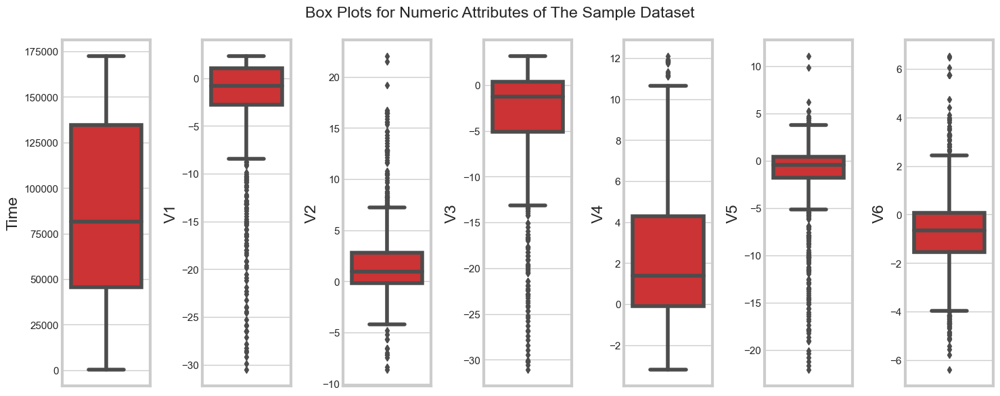

In [3222]:

# Set the color palette
palette = sns.color_palette("Set1")
# Set the style of the plot
sns.set_style("whitegrid")

# Create a box plot for each column grouped by class
plt.figure(figsize=(100, 10))

# Create a figure with subplots
fig, axs = plt.subplots(1, len(set1), figsize=(15, 6))

# Iterate over the columns and create box plots
for i, column in enumerate(set1):
    sns.boxplot(y=column, data=new_dataset, ax=axs[i], palette=palette)

# Set the overall title for the plot
fig.suptitle('Box Plots for Numeric Attributes of The Sample Dataset')
# Adjust the spacing between subplots
fig.tight_layout()
# Show the plot
plt.show()

<Figure size 10000x1000 with 0 Axes>

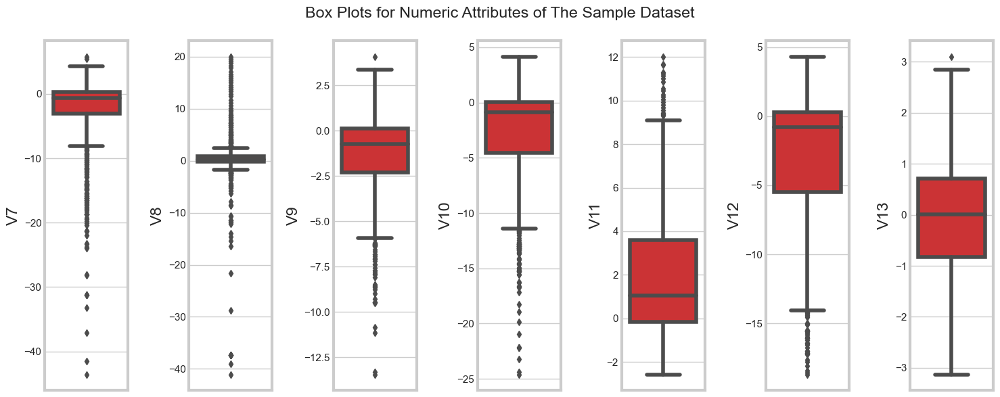

In [3223]:
# Set the color palette
palette = sns.color_palette("Set1")
# Set the style of the plot
sns.set_style("whitegrid")

# Create a box plot for each column grouped by class
plt.figure(figsize=(100, 10))

# Create a figure with subplots
fig, axs = plt.subplots(1, len(set2), figsize=(15, 6))

# Iterate over the columns and create box plots
for i, column in enumerate(set2):
    sns.boxplot(y=column, data=new_dataset, ax=axs[i], palette=palette)

# Set the overall title for the plot
fig.suptitle('Box Plots for Numeric Attributes of The Sample Dataset')
# Adjust the spacing between subplots
fig.tight_layout()
# Show the plot
plt.show()

<Figure size 10000x1000 with 0 Axes>

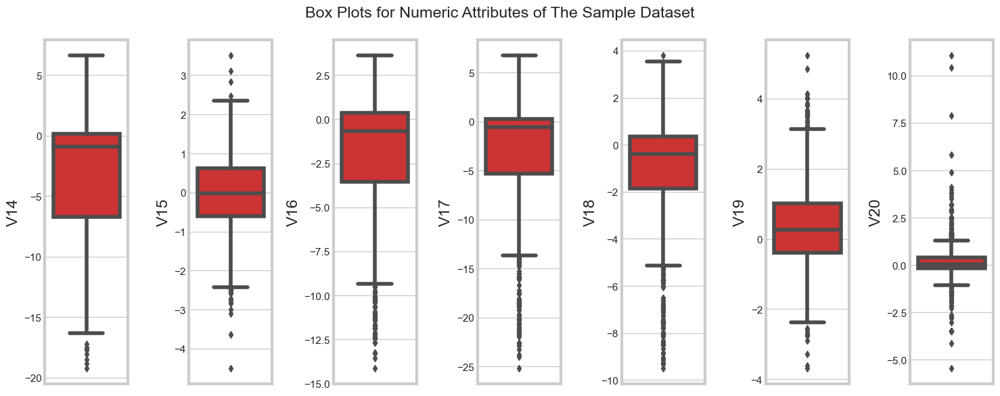

In [3224]:
# Set the color palette
palette = sns.color_palette("Set1")
# Set the style of the plot
sns.set_style("whitegrid")

# Create a box plot for each column grouped by class
plt.figure(figsize=(100, 10))

# Create a figure with subplots
fig, axs = plt.subplots(1, len(set3), figsize=(15, 6))

# Iterate over the columns and create box plots
for i, column in enumerate(set3):
    sns.boxplot(y=column, data=new_dataset, ax=axs[i], palette=palette)

# Set the overall title for the plot
fig.suptitle('Box Plots for Numeric Attributes of The Sample Dataset')
# Adjust the spacing between subplots
fig.tight_layout()
# Show the plot
plt.show()

<Figure size 10000x1000 with 0 Axes>

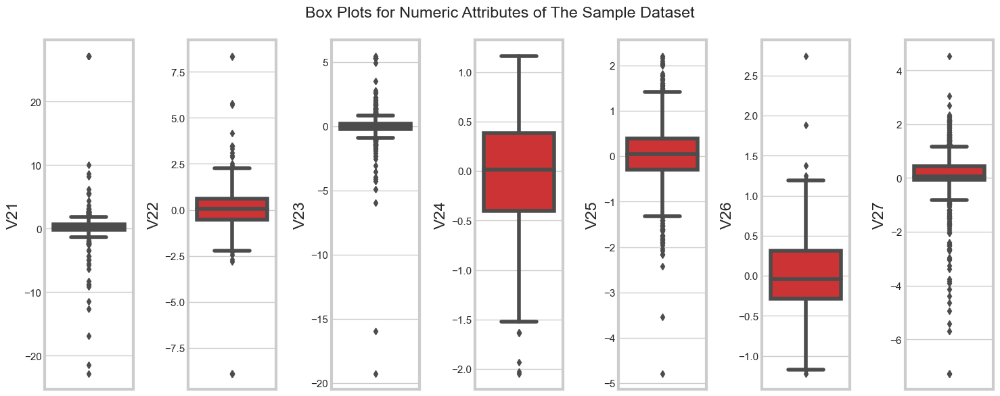

In [3225]:
# Set the color palette
palette = sns.color_palette("Set1")
# Set the style of the plot
sns.set_style("whitegrid")

# Create a box plot for each column grouped by class
plt.figure(figsize=(100, 10))

# Create a figure with subplots
fig, axs = plt.subplots(1, len(set4), figsize=(15, 6))

# Iterate over the columns and create box plots
for i, column in enumerate(set4):
    sns.boxplot(y=column, data=new_dataset, ax=axs[i], palette=palette)

# Set the overall title for the plot
fig.suptitle('Box Plots for Numeric Attributes of The Sample Dataset')
# Adjust the spacing between subplots
fig.tight_layout()
# Show the plot
plt.show()

<Figure size 10000x1000 with 0 Axes>

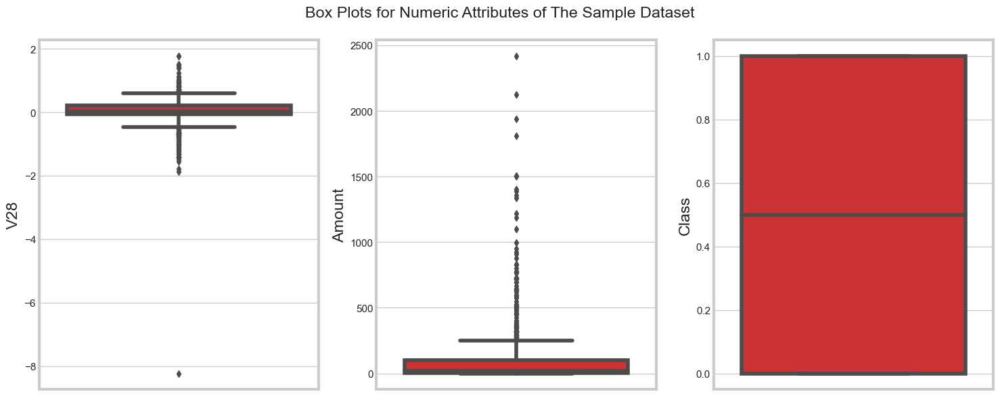

In [3226]:
# Set the color palette
palette = sns.color_palette("Set1")
# Set the style of the plot
sns.set_style("whitegrid")

# Create a box plot for each column grouped by class
plt.figure(figsize=(100, 10))

# Create a figure with subplots
fig, axs = plt.subplots(1, len(set5), figsize=(15, 6))

# Iterate over the columns and create box plots
for i, column in enumerate(set5):
    sns.boxplot(y=column, data=new_dataset, ax=axs[i], palette=palette)

# Set the overall title for the plot
fig.suptitle('Box Plots for Numeric Attributes of The Sample Dataset')
# Adjust the spacing between subplots
fig.tight_layout()
# Show the plot
plt.show()

### Correlation Heatmap for all the Attributes in the Balanced Dataset:

In [3227]:
def draw_Pearson_Correlation_Heatmap(df):
    # Create a correlation matrix
    corr_matrix = df.corr()
    
    # Plot the correlation matrix
    plt.figure(figsize=(200,200))
    sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", square=True,annot_kws={"fontsize": 110})
    
    plt.style.use('fivethirtyeight')
    
    # Set plot title
    plt.title("Pearson Correlation Coefficient Heatmap")

    # Show the plot
    plt.show()

In [3228]:
draw_Pearson_Correlation_Heatmap(new_dataset)

> ***Dropping Pairs of Highly Correlated Columns***

In [3229]:
def drop_highly_correlated_columns(df, threshold):
    # Create a correlation matrix
    corr_matrix = df.corr().abs()
    
    # Create a mask to identify highly correlated columns
    mask = corr_matrix.mask(~(corr_matrix > threshold), 0)
    
    # Find the columns to drop
    columns_to_drop = set()
    for column in mask.columns:
        correlated_columns = mask[mask[column] > 0].index.tolist()
        columns_to_drop.update(correlated_columns[1:])  # Drop all but the first column in each pair
    
    # Drop the highly correlated columns
    df_dropped = df.drop(columns=columns_to_drop)

    return df_dropped

threshold = 0.975 # Define the correlation threshold
new_dataset = drop_highly_correlated_columns(new_dataset, threshold)

> ***Dropping Cloumns which are highly uncorrelated with the Target Class***

In [3230]:
def drop_low_correlation_columns(df, target_column, threshold):
    # Calculate the correlation between each feature and the target column
    correlations = df.drop(columns=target_column).corrwith(df[target_column])
    
    # Find the columns with correlation below the threshold
    columns_to_drop = correlations[correlations.abs() < threshold].index.tolist()
    
    # Drop the columns with low correlation
    df_dropped = df.drop(columns=columns_to_drop)
    
    return df_dropped

target_column = 'Class'  
threshold = 0.05  # Define the correlation threshold to 0.05
new_dataset = drop_low_correlation_columns(new_dataset, target_column, threshold)

> ***Removing Outliers - data observations with values higher than the 6 std deviation of the corresponding attribute***

In [3231]:
# Calculate Z-scores for the specified columns
z_scores = new_dataset.apply(zscore)

# Remove rows where any of the Z-scores exceed a threshold (e.g., 5)
threshold = 6
new_dataset = new_dataset[(np.abs(z_scores) <= threshold).all(axis=1)]

### Final Cleaned Dataset 

In [3232]:
new_dataset.head(3)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V18,V19,V20,V21,V24,V26,V27,V28,Amount,Class
97845,66407.0,1.047700,-1.188304,0.926659,-0.696854,-0.733028,2.176644,-1.525119,0.827387,-0.165794,...,-0.257650,-1.746684,-0.566570,-0.308137,-1.326357,0.890175,0.066777,0.001024,41.63,0
234496,148000.0,2.320144,-0.584930,-2.780143,-1.177819,0.539908,-0.952781,0.199496,-0.341845,-1.014795,...,-0.841150,1.267199,-0.153924,0.461563,0.246366,0.286700,-0.114827,-0.107174,1.79,0
3667,3137.0,1.246679,0.067796,0.211026,0.930449,0.046815,0.414423,-0.220463,0.182975,0.421528,...,0.425399,0.786575,-0.167432,-0.293359,-0.865866,-0.468184,0.029277,0.002466,1.00,0


In [3233]:
new_dataset.shape

(966, 27)

In [3234]:
print('No. of Legit Entries : ',new_dataset[new_dataset['Class']==0].shape[0])

No. of Legit Entries :  489


In [3235]:
print('No. of Fraud Entries : ',new_dataset[new_dataset['Class']==1].shape[0])

No. of Fraud Entries :  477


In [3236]:
new_columns = new_dataset.columns

In [3237]:
removed_columns = list(set(all_columns) - set(new_columns))
print(removed_columns)

['V15', 'V23', 'V25', 'V22']


#### Pearson Correlation Coefficient Heatmap for the Final Cleaned Dataset

In [3238]:
draw_Pearson_Correlation_Heatmap(new_dataset)

### Splitting the data into features (X) and targets/labels (Y)


In [3239]:
X_start = new_dataset.drop(columns = 'Class', axis = 1)
Y_start = new_dataset['Class']

In [3240]:
X_start

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V17,V18,V19,V20,V21,V24,V26,V27,V28,Amount
97845,66407.0,1.047700,-1.188304,0.926659,-0.696854,-0.733028,2.176644,-1.525119,0.827387,-0.165794,...,1.020409,-0.257650,-1.746684,-0.566570,-0.308137,-1.326357,0.890175,0.066777,0.001024,41.63
234496,148000.0,2.320144,-0.584930,-2.780143,-1.177819,0.539908,-0.952781,0.199496,-0.341845,-1.014795,...,0.189971,-0.841150,1.267199,-0.153924,0.461563,0.246366,0.286700,-0.114827,-0.107174,1.79
3667,3137.0,1.246679,0.067796,0.211026,0.930449,0.046815,0.414423,-0.220463,0.182975,0.421528,...,-0.697913,0.425399,0.786575,-0.167432,-0.293359,-0.865866,-0.468184,0.029277,0.002466,1.00
92966,64192.0,-0.528536,1.163222,0.730085,0.940935,-0.406774,-0.570687,0.400705,0.318691,-0.947077,...,-0.246102,0.514839,0.559915,-0.149117,0.248674,0.552505,-0.368109,-0.154315,-0.046024,42.81
276436,167091.0,1.747221,-1.225641,-2.842732,-0.302332,0.148971,-1.218238,0.848595,-0.628525,-1.132648,...,0.238396,0.669114,-0.787732,-0.103352,0.048288,0.748156,0.965194,-0.176714,-0.040679,274.98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204503,135314.0,-3.158990,1.765452,-3.390168,0.987410,-1.509930,-1.280952,-2.719557,0.718325,-1.660183,...,-9.334329,-2.580249,1.501573,-0.022590,1.120533,-0.251283,-0.004327,-0.235477,0.018129,84.28
50537,44532.0,-0.234922,0.355413,1.972183,-1.255593,-0.681387,-0.665732,0.059110,-0.003153,1.122451,...,-0.207707,0.380542,0.574336,-0.003469,0.220670,0.451208,-0.531846,0.123185,0.039581,1.00
16863,28242.0,-2.787248,-0.071340,-1.505288,3.361777,-3.357422,0.565835,0.303653,0.966914,-2.245882,...,-5.841218,-2.910430,-1.155850,1.607397,0.882940,0.219925,-0.265894,0.220694,0.256077,730.86
274382,165981.0,-5.766879,-8.402154,0.056543,6.950983,9.880564,-5.773192,-5.748879,0.721743,-1.076274,...,0.327464,0.091470,1.307941,2.493224,0.880395,0.665346,-0.120803,0.073269,0.583799,0.00


In [3241]:
Y_start

97845     0
234496    0
3667      0
92966     0
276436    0
         ..
204503    1
50537     1
16863     1
274382    1
184379    1
Name: Class, Length: 966, dtype: int64

In [3242]:
### Standardizing the Features X using StandardScala

In [3243]:
from sklearn.preprocessing import StandardScaler

# Assuming you have your dataset stored in a variable called 'X'
# Create an instance of the StandardScaler
scaler = StandardScaler()

# Fit the scaler to your data
scaler.fit(X_start)

# Transform the data by applying standardization
X_standardized = scaler.transform(X_start)

X_standardized

array([[-0.45044977,  0.61733106, -0.88522647, ..., -0.06369099,
        -0.07450769, -0.27809359],
       [ 1.22049731,  0.86873873, -0.69868868, ..., -0.28358039,
        -0.34728994, -0.4789807 ],
       [-1.74615923,  0.65664511, -0.49689307, ..., -0.10909681,
        -0.07087292, -0.48296416],
       ...,
       [-1.23203269, -0.14037256, -0.53990826, ...,  0.12267481,
         0.56851331,  3.19724336],
       [ 1.58873109, -0.72908384, -3.1154467 , ..., -0.0558306 ,
         1.39474466, -0.4880065 ],
       [ 0.77444313,  0.18478037,  0.07809582, ..., -0.32144799,
         0.11504919, -0.36194782]])

In [3244]:
X = np.copy(X_standardized)
Y = np.copy(Y_start)

In [3245]:
print(X)

[[-0.45044977  0.61733106 -0.88522647 ... -0.06369099 -0.07450769
  -0.27809359]
 [ 1.22049731  0.86873873 -0.69868868 ... -0.28358039 -0.34728994
  -0.4789807 ]
 [-1.74615923  0.65664511 -0.49689307 ... -0.10909681 -0.07087292
  -0.48296416]
 ...
 [-1.23203269 -0.14037256 -0.53990826 ...  0.12267481  0.56851331
   3.19724336]
 [ 1.58873109 -0.72908384 -3.1154467  ... -0.0558306   1.39474466
  -0.4880065 ]
 [ 0.77444313  0.18478037  0.07809582 ... -0.32144799  0.11504919
  -0.36194782]]


In [3246]:
print(Y)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 

# MODEL TRAINING AND EVALUATION

> ## K-Fold Cross Validation Technique to get the Best Model according to accuracy

In [3247]:
from sklearn.ensemble import BaggingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import confusion_matrix
import joblib

# Load your dataset and split it into features (X) and labels (y)

XTrg, XTst, yTrg, yTst = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)


# Define the number of folds for k-fold cross-validation
k = 10

# Create a k-fold cross-validator
kf = KFold(n_splits=k, shuffle=True)

# Ensemble Bagging using Logistic Regression

> ## Using K-Fold Cross Validatin Technique we will find most accurate Logistic Regression Bagging Model for our Dataset

In [3248]:
# Ensemble Bagging using Logistic Regression
base_model_lr = LogisticRegression()
bagging_model_lr = BaggingClassifier(base_model_lr, n_estimators=300)

# Perform k-fold cross-validation for Logistic Regression Bagging
acc_scores = []
f1_scores = []

lr_bagging_models = []
for train_index, test_index in kf.split(XTrg):
    X_train, X_test = XTrg[train_index], XTrg[test_index]
    y_train, y_test = yTrg[train_index], yTrg[test_index]

    bagging_model_lr.fit(X_train, y_train)

    #Storing LR Models here
    lr_bagging_models.append(bagging_model_lr)

    y_pred_lr = bagging_model_lr.predict(X_test)

    #Storing accuracy here
    acc_scores.append(accuracy_score(y_test, y_pred_lr))
    
    #Storing f1 score here
    f1_scores.append(f1_score(y_test,y_pred_lr))

# Find the best Logistic Regression Bagging model based on the highest accuracy score
best_acc_index_lr = np.argmax(acc_scores)
best_model_lr = lr_bagging_models[best_acc_index_lr]

print("Logistic Regression Bagging Metrics\n\n")

print('Best Logistic Regression Bagging model based on the highest accuracy score')
print('Best Accuracy Score : ',acc_scores[best_acc_index_lr])
print('\n\nOther Scores And Classification Report on Test Data\n\n')
# Calculate evaluation metrics for Logistic Regression Bagging on test dataset
y_pred_lr_test = best_model_lr.predict(XTst)
print("Accuracy:", accuracy_score(yTst, y_pred_lr_test))
print("Precision:", precision_score(yTst, y_pred_lr_test))
print("Recall:", recall_score(yTst, y_pred_lr_test))
print("F1 Score:", f1_score(yTst, y_pred_lr_test))
print("\n\n",classification_report(yTst, y_pred_lr_test))

print('\n\n')

# Find the best Logistic Regression Bagging model based on the highest f1 score
best_f1_index_lr = np.argmax(f1_scores)
best_model_lr = lr_bagging_models[best_f1_index_lr]

print('Best Logistic Regression Bagging model based on the highest f1 score')
print('Best F1 Score : ',f1_scores[best_f1_index_lr])
print('\n\nOther Scores And Classification Report on Test Data Set\n\n')
# Calculate evaluation metrics for Logistic Regression Bagging on test dataset
y_pred_lr_test = best_model_lr.predict(XTst)
print("Accuracy:", accuracy_score(yTst, y_pred_lr_test))
print("Precision:", precision_score(yTst, y_pred_lr_test))
print("Recall:", recall_score(yTst, y_pred_lr_test))
print("F1 Score:", f1_score(yTst, y_pred_lr_test))
print("\n\n",classification_report(yTst, y_pred_lr_test))

print('\n\n')

Logistic Regression Bagging Metrics


Best Logistic Regression Bagging model based on the highest accuracy score
Best Accuracy Score :  0.987012987012987


Other Scores And Classification Report on Test Data


Accuracy: 0.9484536082474226
Precision: 0.9777777777777777
Recall: 0.9166666666666666
F1 Score: 0.946236559139785


               precision    recall  f1-score   support

           0       0.92      0.98      0.95        98
           1       0.98      0.92      0.95        96

    accuracy                           0.95       194
   macro avg       0.95      0.95      0.95       194
weighted avg       0.95      0.95      0.95       194




Best Logistic Regression Bagging model based on the highest f1 score
Best F1 Score :  0.9859154929577464


Other Scores And Classification Report on Test Data Set


Accuracy: 0.9484536082474226
Precision: 0.9777777777777777
Recall: 0.9166666666666666
F1 Score: 0.946236559139785


               precision    recall  f1-score   support

      

In [3249]:
pd.DataFrame(yTst,columns=['Class']).value_counts()

Class
0        98
1        96
Name: count, dtype: int64

In [3250]:
pd.DataFrame(y_pred_lr_test,columns=['Class']).value_counts()

Class
0        104
1         90
Name: count, dtype: int64

## Confusion Matrix (Logistic Regression Bagging model)

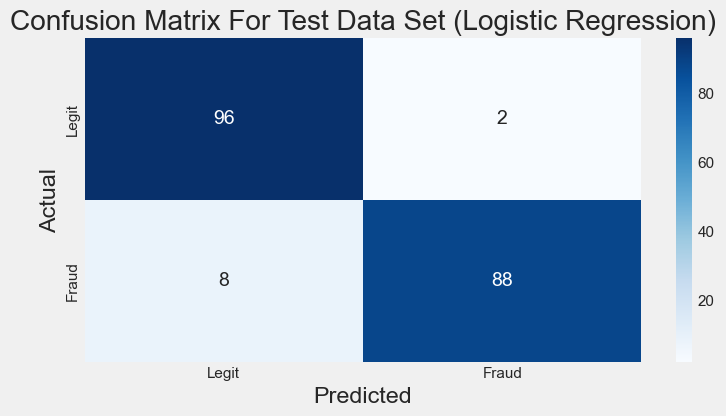

In [3251]:
# Create the confusion matrix
cm = confusion_matrix(yTst, y_pred_lr_test)

# Define class labels (optional)
class_labels = ['Legit', 'Fraud']

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)

# Add labels, title, and axis ticks
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix For Test Data Set (Logistic Regression)")
plt.xticks(np.arange(len(class_labels)) + 0.5, class_labels)
plt.yticks(np.arange(len(class_labels)) + 0.5, class_labels)

# Display the plot
plt.show()

# Ensemble Bagging using Decision Trees

> ### Using K-Fold Cross Validatin Technique we will find most accurate Decision Tree Bagging model for our Dataset

In [3252]:
# Ensemble Bagging using Decision Trees
base_model_dt = DecisionTreeClassifier()
bagging_model_dt = BaggingClassifier(base_model_dt, n_estimators=300)

# Perform k-fold cross-validation for Decision Tree Bagging model
acc_scores = []
f1_scores = []
dt_bagging_models = []
for train_index, test_index in kf.split(XTrg):
    X_train, X_test = XTrg[train_index], XTrg[test_index]
    y_train, y_test = yTrg[train_index], yTrg[test_index]

    bagging_model_dt.fit(X_train, y_train)

    #Storing DT Models here
    dt_bagging_models.append(bagging_model_dt)
    y_pred_dt = bagging_model_dt.predict(X_test)
    
    #Storing accuracy here
    acc_scores.append(accuracy_score(y_test, y_pred_dt))
    
    #Storing f1 score here
    f1_scores.append(f1_score(y_test,y_pred_dt))

# Find the best Decision Tree Bagging model based on the highest accuracy score
best_acc_index_dt = np.argmax(acc_scores)
best_model_dt = dt_bagging_models[best_acc_index_dt]

print("Decision Tree Bagging Metrics\n\n")

print('Best Decision Tree Bagging model based on the highest accuracy score')
print('Best Accuracy Score : ',acc_scores[best_acc_index_dt])

print('\n\nOther Scores And Classification Report on Test Data\n\n')
# Calculate evaluation metrics for Decision Tree Bagging model on test dataset
y_pred_dt_test = best_model_dt.predict(XTst)
print("Accuracy:", accuracy_score(yTst, y_pred_dt_test))
print("Precision:", precision_score(yTst, y_pred_dt_test))
print("Recall:", recall_score(yTst, y_pred_dt_test))
print("F1 Score:", f1_score(yTst, y_pred_dt_test))
print("\n\n",classification_report(yTst, y_pred_dt_test))

print('\n\n')

# Find the best Decision Tree Bagging model based on the highest f1 score
best_f1_index_dt = np.argmax(f1_scores)
best_model_dt = dt_bagging_models[best_f1_index_dt]

print('Best Decision Tree Bagging model based on the highest f1 score')
print('Best F1 Score : ',f1_scores[best_f1_index_dt])
print('\n\nOther Scores And Classification Report on Test Data Set\n\n')
# Calculate evaluation metrics for Decision Tree Bagging model on test dataset
y_pred_dt_test = best_model_dt.predict(XTst)
print("Accuracy:", accuracy_score(yTst, y_pred_dt_test))
print("Precision:", precision_score(yTst, y_pred_dt_test))
print("Recall:", recall_score(yTst, y_pred_dt_test))
print("F1 Score:", f1_score(yTst, y_pred_dt_test))
print("\n\n",classification_report(yTst, y_pred_dt_test))

print('\n\n')

Decision Tree Bagging Metrics


Best Decision Tree Bagging model based on the highest accuracy score
Best Accuracy Score :  0.987012987012987


Other Scores And Classification Report on Test Data


Accuracy: 0.9536082474226805
Precision: 1.0
Recall: 0.90625
F1 Score: 0.9508196721311475


               precision    recall  f1-score   support

           0       0.92      1.00      0.96        98
           1       1.00      0.91      0.95        96

    accuracy                           0.95       194
   macro avg       0.96      0.95      0.95       194
weighted avg       0.96      0.95      0.95       194




Best Decision Tree Bagging model based on the highest f1 score
Best F1 Score :  0.988235294117647


Other Scores And Classification Report on Test Data Set


Accuracy: 0.9536082474226805
Precision: 1.0
Recall: 0.90625
F1 Score: 0.9508196721311475


               precision    recall  f1-score   support

           0       0.92      1.00      0.96        98
           1       1.

In [3253]:
pd.DataFrame(yTst,columns=['Class']).value_counts()

Class
0        98
1        96
Name: count, dtype: int64

In [3254]:
pd.DataFrame(y_pred_dt_test,columns=['Class']).value_counts()

Class
0        107
1         87
Name: count, dtype: int64

## Confusion Matrix (Decision Tree Bagging model)

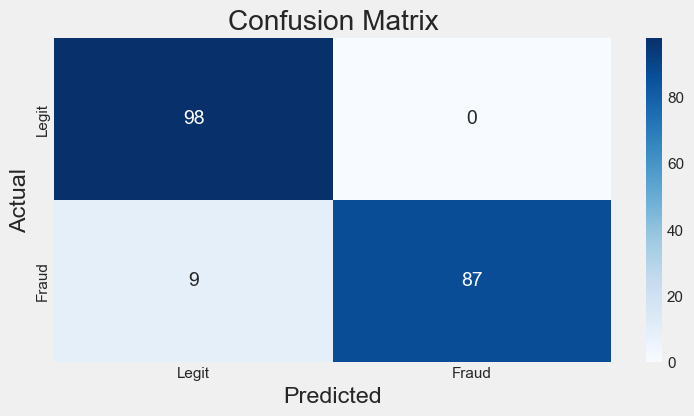

In [3255]:
# Create the confusion matrix
cm = confusion_matrix(yTst, y_pred_dt_test)

# Define class labels (optional)
class_labels = ['Legit', 'Fraud']

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)

# Add labels, title, and axis ticks
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.xticks(np.arange(len(class_labels)) + 0.5, class_labels)
plt.yticks(np.arange(len(class_labels)) + 0.5, class_labels)

# Display the plot
plt.show()

# Saving The Models

In [3256]:
# Save the best Logistic Regression Bagging model to a file
joblib.dump(best_model_lr, 'best_model_lr.pkl')

['best_model_lr.pkl']

In [3257]:
# Save the best Decision Tree model to a file
joblib.dump(best_model_dt, 'best_model_dt.pkl')

['best_model_dt.pkl']